In [1]:
import os
import pathlib

import matplotlib.pyplot as plt
import numpy as np
import seaborn as sns
import tensorflow as tf

from tensorflow.keras.layers.experimental import preprocessing
from tensorflow.keras import layers
from tensorflow.keras import models
from IPython import display


# Set seed for experiment reproducibility
seed = 42
tf.random.set_seed(seed)
np.random.seed(seed)

INFO:tensorflow:Enabling eager execution
INFO:tensorflow:Enabling v2 tensorshape
INFO:tensorflow:Enabling resource variables
INFO:tensorflow:Enabling tensor equality
INFO:tensorflow:Enabling control flow v2


In [2]:
data_dir = pathlib.Path('tensorflow-speech-recognition-challenge\\train\\audio')


In [3]:
commands = np.array(tf.io.gfile.listdir(str(data_dir)))
commands = commands[commands != 'README.md']
print('Commands:', commands)
commands = ['unknown', 'silence', 'yes', 'no', 'up', 'down', 'left', 'right', 'on', 'off', 'stop', 'go']

Commands: ['bed' 'bird' 'cat' 'dog' 'down' 'eight' 'five' 'four' 'go' 'happy'
 'house' 'left' 'marvin' 'nine' 'no' 'off' 'on' 'one' 'right' 'seven'
 'sheila' 'silence' 'six' 'stop' 'three' 'tree' 'two' 'up' 'wow' 'yes'
 'zero']


In [4]:
filenames = tf.io.gfile.glob(str(data_dir) + '/*/*')
filenames = tf.random.shuffle(filenames)
num_samples = len(filenames)
print('Number of total examples:', num_samples)
#print('Number of examples per label:',
#      len(tf.io.gfile.listdir(str(data_dir/commands[0]))))
print('Example file tensor:', filenames[0])

Number of total examples: 68659
Example file tensor: tf.Tensor(b'tensorflow-speech-recognition-challenge\\train\\audio\\cat\\99081f4d_nohash_2.wav', shape=(), dtype=string)


In [5]:
test_dir = 'tensorflow-speech-recognition-challenge/test/audio'
test_files = tf.io.gfile.glob(str(test_dir) + '/*')

In [6]:
train_files = filenames[:58255]
val_files = filenames[58255:]
print('Training set size', len(train_files))
print('Validation set size', len(val_files))
print('Test set size', len(test_files))

Training set size 58255
Validation set size 10404
Test set size 158538


In [7]:
def decode_audio(audio_binary):
  audio, _ = tf.audio.decode_wav(audio_binary)
  return tf.squeeze(audio, axis=-1)

In [8]:
@tf.function
def get_label(file_path):
  parts = tf.strings.split(file_path, os.path.sep)
  known_labels = ['yes', 'no', 'up', 'down', 'left', 'right', 'on', 'off', 'stop', 'go']
  # Note: You'll use indexing here instead of tuple unpacking to enable this 
  # to work in a TensorFlow graph.
  #label = parts[-2]
  if parts[-2] == 'yes' or parts[-2] == 'no' or parts[-2] == 'up' or parts[-2] == 'down' or parts[-2] == 'left' or parts[-2] == 'right' or parts[-2] == 'on' or parts[-2] == 'off' or parts[-2] == 'stop' or parts[-2] == 'go' or parts[-2] == 'silence':
    return parts[-2]
  else: return 'unknown'


In [9]:
def get_waveform_and_label(file_path):
  label = get_label(file_path)
  audio_binary = tf.io.read_file(file_path)
  waveform = decode_audio(audio_binary)
  return waveform, label

In [10]:
AUTOTUNE = tf.data.AUTOTUNE
files_ds = tf.data.Dataset.from_tensor_slices(train_files)
waveform_ds = files_ds.map(get_waveform_and_label, num_parallel_calls=AUTOTUNE)

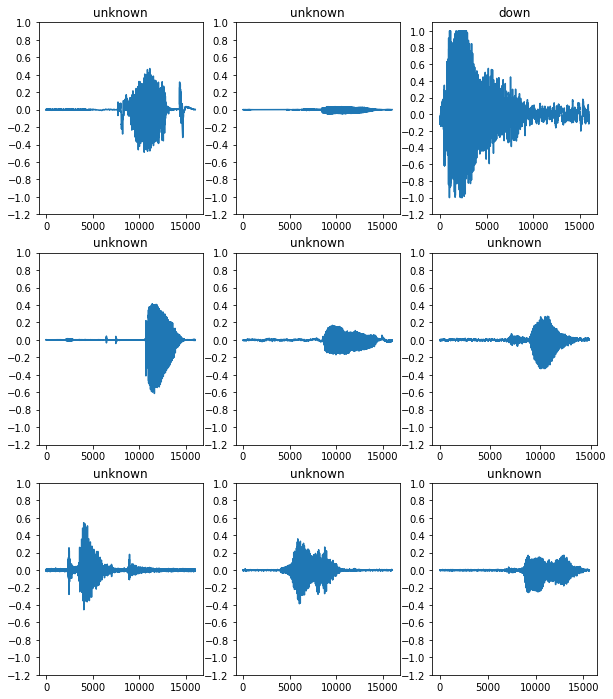

In [11]:
rows = 3
cols = 3
n = rows*cols
fig, axes = plt.subplots(rows, cols, figsize=(10, 12))
for i, (audio, label) in enumerate(waveform_ds.take(n)):
  r = i // cols
  c = i % cols
  ax = axes[r][c]
  ax.plot(audio.numpy())
  ax.set_yticks(np.arange(-1.2, 1.2, 0.2))
  label = label.numpy().decode('utf-8')
  ax.set_title(label)

plt.show()

In [12]:
def get_spectrogram(waveform):
  # Padding for files with less than 16000 samples
  zero_padding = tf.zeros([16000] - tf.shape(waveform), dtype=tf.float32)

  # Concatenate audio with padding so that all audio clips will be of the 
  # same length
  waveform = tf.cast(waveform, tf.float32)
  equal_length = tf.concat([waveform, zero_padding], 0)
  spectrogram = tf.signal.stft(
      equal_length, frame_length=255, frame_step=128)

  spectrogram = tf.abs(spectrogram)

  return spectrogram

In [13]:
for waveform, label in waveform_ds.take(1):
  label = label.numpy().decode('utf-8')
  spectrogram = get_spectrogram(waveform)

print('Label:', label)
print('Waveform shape:', waveform.shape)
print('Spectrogram shape:', spectrogram.shape)
print('Audio playback')
display.display(display.Audio(waveform, rate=16000))

Label: unknown
Waveform shape: (16000,)
Spectrogram shape: (124, 129)
Audio playback


<ipython-input-14-a0f06cbf7ae8>:9: MatplotlibDeprecationWarning: shading='flat' when X and Y have the same dimensions as C is deprecated since 3.3.  Either specify the corners of the quadrilaterals with X and Y, or pass shading='auto', 'nearest' or 'gouraud', or set rcParams['pcolor.shading'].  This will become an error two minor releases later.
  ax.pcolormesh(X, Y, log_spec)


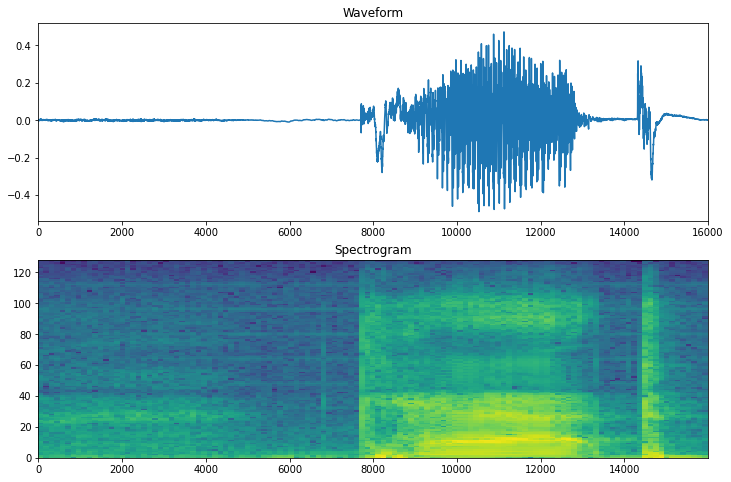

In [14]:
def plot_spectrogram(spectrogram, ax):
  # Convert to frequencies to log scale and transpose so that the time is
  # represented in the x-axis (columns).
  log_spec = np.log(spectrogram.T)
  height = log_spec.shape[0]
  width = log_spec.shape[1]
  X = np.linspace(0, np.size(spectrogram), num=width, dtype=int)
  Y = range(height)
  ax.pcolormesh(X, Y, log_spec)


fig, axes = plt.subplots(2, figsize=(12, 8))
timescale = np.arange(waveform.shape[0])
axes[0].plot(timescale, waveform.numpy())
axes[0].set_title('Waveform')
axes[0].set_xlim([0, 16000])
plot_spectrogram(spectrogram.numpy(), axes[1])
axes[1].set_title('Spectrogram')
plt.show()

In [15]:
def get_spectrogram_and_label_id(audio, label):
  spectrogram = get_spectrogram(audio)
  spectrogram = tf.expand_dims(spectrogram, -1)
  label_id = tf.argmax(label == commands)
  return spectrogram, label_id

In [16]:
spectrogram_ds = waveform_ds.map(
    get_spectrogram_and_label_id, num_parallel_calls=AUTOTUNE)

<ipython-input-14-a0f06cbf7ae8>:9: MatplotlibDeprecationWarning: shading='flat' when X and Y have the same dimensions as C is deprecated since 3.3.  Either specify the corners of the quadrilaterals with X and Y, or pass shading='auto', 'nearest' or 'gouraud', or set rcParams['pcolor.shading'].  This will become an error two minor releases later.
  ax.pcolormesh(X, Y, log_spec)
<ipython-input-14-a0f06cbf7ae8>:4: RuntimeWarning: divide by zero encountered in log
  log_spec = np.log(spectrogram.T)


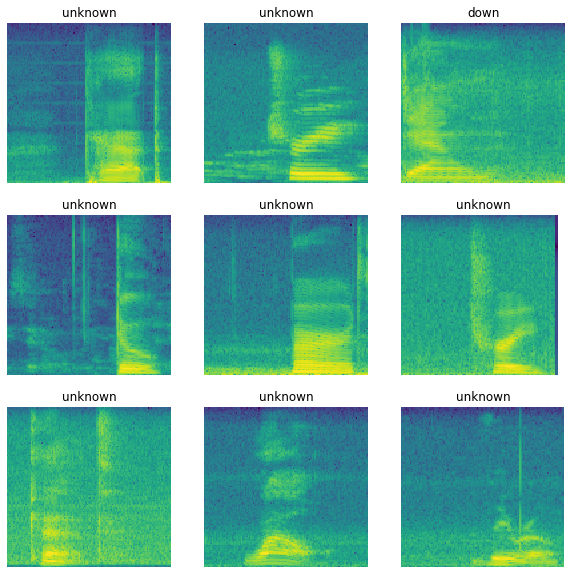

In [17]:
rows = 3
cols = 3
n = rows*cols
fig, axes = plt.subplots(rows, cols, figsize=(10, 10))
for i, (spectrogram, label_id) in enumerate(spectrogram_ds.take(n)):
  r = i // cols
  c = i % cols
  ax = axes[r][c]
  plot_spectrogram(np.squeeze(spectrogram.numpy()), ax)
  ax.set_title(commands[label_id.numpy()])
  ax.axis('off')

plt.show()

In [18]:
def preprocess_dataset(files, test=False):
  files_ds = tf.data.Dataset.from_tensor_slices(files)
  if test:
    output_ds = files_ds.map(get_waveform_and_label, num_parallel_calls=1)
    output_ds = output_ds.map(
        get_spectrogram_and_label_id,  num_parallel_calls=1)
  else:
    output_ds = files_ds.map(get_waveform_and_label, num_parallel_calls=AUTOTUNE)
    output_ds = output_ds.map(
        get_spectrogram_and_label_id,  num_parallel_calls=AUTOTUNE)
  return output_ds

In [19]:
train_ds = spectrogram_ds
val_ds = preprocess_dataset(val_files)
test_ds = preprocess_dataset(test_files, True)

In [20]:
batch_size = 64
train_ds = train_ds.batch(batch_size)
val_ds = val_ds.batch(batch_size)

In [21]:
train_ds = train_ds.cache().prefetch(AUTOTUNE)
val_ds = val_ds.cache().prefetch(AUTOTUNE)

In [22]:
for spectrogram, _ in spectrogram_ds.take(1):
  input_shape = spectrogram.shape
print('Input shape:', input_shape)
num_labels = len(commands)

# def simple_rnn_model(input_dim, output_dim=29):
#     """ Build a recurrent network for speech 
#     """
#     # Main acoustic input
#     input_data = layers.Input(name='the_input', shape=(None, input_dim))
#     # Add recurrent layer
#     simp_rnn = layers.GRU(output_dim, return_sequences=False, 
#                  implementation=2, name='rnn')(input_data)
#     # Add softmax activation layer
#     y_pred = layers.Activation('softmax', name='softmax')(simp_rnn)
#     # Specify the model
#     model = models.Model(inputs=input_data, outputs=y_pred)
#     model.output_length = lambda x: x
#     print(model.summary())
#     return model

# model = simple_rnn_model(129, num_labels)


Input shape: (124, 129, 1)


In [23]:
# model.compile(
#     optimizer=tf.keras.optimizers.Adam(),
#     loss=tf.keras.losses.SparseCategoricalCrossentropy(from_logits=False),
#     metrics=['accuracy'],
# )

In [24]:
# EPOCHS = 100
# history = model.fit(
#     train_ds, 
#     validation_data=val_ds,  
#     epochs=EPOCHS,
#     #callbacks=tf.keras.callbacks.EarlyStopping(verbose=1, patience=2),
# )

In [25]:
def conv_rnn(input_dim, output_dim=29):
    """ Build a recurrent network for speech 
    """
    # Main acoustic input
    input_data = layers.Input(name='the_input', shape=(None, input_dim))

    x = layers.BatchNormalization(axis=-1, momentum=0.99, epsilon=1e-3, center=True, scale=True)(input_data)

    x = layers.Conv1D(8,13, padding='valid', activation='linear', strides=1)(x)
    x = layers.LeakyReLU()(x)
    x = layers.MaxPooling1D(3)(x)
    x = layers.Dropout(0.3)(x)

    x = layers.Conv1D(16, 11, padding='valid', activation='linear', strides=1)(x)
    x = layers.LeakyReLU()(x)
    x = layers.MaxPooling1D(3)(x)
    x = layers.Dropout(0.3)(x)

    #x = layers.Conv1D(32, 9, padding='valid', activation='relu', strides=1)(x)
    #x = layers.MaxPooling1D(3)(x)
    #x = layers.Dropout(0.3)(x)

    x = layers.BatchNormalization(axis=-1, momentum=0.99, epsilon=1e-3, center=True, scale=True)(x)
    x = layers.Bidirectional(layers.GRU(128, return_sequences=True), merge_mode='sum')(x)
    x = layers.Bidirectional(layers.GRU(128, return_sequences=True), merge_mode='sum')(x)
    x = layers.Bidirectional(layers.GRU(128, return_sequences=False), merge_mode='sum')(x)

    x = layers.BatchNormalization(axis=-1, momentum=0.99, epsilon=1e-3, center=True, scale=True)(x)

    x = layers.Flatten()(x)
    x = layers.Dropout(0.3)(x)
    x = layers.Dense(256, activation='linear')(x)
    x = layers.LeakyReLU()(x)
    x = layers.Dropout(0.3)(x)
    x = layers.Dense(128, activation='linear')(x)
    x = layers.LeakyReLU()(x)
    x = layers.Dropout(0.3)(x)
    outputs = layers.Dense(output_dim, activation="softmax")(x)
    # Add softmax activation layer
    # Specify the model
    model = models.Model(input_data, outputs)
    print(model.summary())
    return model

model = conv_rnn(129, num_labels)

Model: "model"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
the_input (InputLayer)       [(None, None, 129)]       0         
_________________________________________________________________
batch_normalization (BatchNo (None, None, 129)         516       
_________________________________________________________________
conv1d (Conv1D)              (None, None, 8)           13424     
_________________________________________________________________
leaky_re_lu (LeakyReLU)      (None, None, 8)           0         
_________________________________________________________________
max_pooling1d (MaxPooling1D) (None, None, 8)           0         
_________________________________________________________________
dropout (Dropout)            (None, None, 8)           0         
_________________________________________________________________
conv1d_1 (Conv1D)            (None, None, 16)          1424  

In [26]:
model.compile(
    optimizer=tf.keras.optimizers.Adam(),
    loss=tf.keras.losses.SparseCategoricalCrossentropy(from_logits=False),
    metrics=['accuracy'],
)

In [27]:
EPOCHS = 20
history = model.fit(
    train_ds, 
    validation_data=val_ds,  
    epochs=EPOCHS,
    #callbacks=tf.keras.callbacks.EarlyStopping(verbose=1, patience=2),
)

Epoch 1/20
911/911 [==============================] - 335s 339ms/step - loss: 1.4245 - accuracy: 0.6218 - val_loss: 0.8757 - val_accuracy: 0.7114
Epoch 2/20
911/911 [==============================] - 36s 40ms/step - loss: 0.8966 - accuracy: 0.7121 - val_loss: 0.5511 - val_accuracy: 0.8218
Epoch 3/20
911/911 [==============================] - 35s 38ms/step - loss: 0.7137 - accuracy: 0.7675 - val_loss: 0.4844 - val_accuracy: 0.8412
Epoch 4/20
911/911 [==============================] - 35s 38ms/step - loss: 0.6491 - accuracy: 0.7903 - val_loss: 0.4305 - val_accuracy: 0.8608
Epoch 5/20
911/911 [==============================] - 37s 40ms/step - loss: 0.5977 - accuracy: 0.8049 - val_loss: 0.4131 - val_accuracy: 0.8605
Epoch 6/20
911/911 [==============================] - 38s 41ms/step - loss: 0.5581 - accuracy: 0.8197 - val_loss: 0.3756 - val_accuracy: 0.8729
Epoch 7/20
911/911 [==============================] - 36s 40ms/step - loss: 0.5316 - accuracy: 0.8296 - val_loss: 0.3438 - val_accurac

In [28]:
history

In [29]:
#test_audio = []

#for audio, label in test_ds:
# test_audio.append(audio.numpy())
#  test_labels.append(label.numpy())

#test_audio = np.array(test_audio)
#test_files = [f.split(r'\\')[-1] for f in test_files]

In [32]:

j = 0
preds = []
audios = []
for audio, label in test_ds:
    audios.append(audio.numpy())
    j += 1
    if j == 999:
        y_pred = np.argmax(model.predict(np.array(audios)), axis=1)
        preds.append(y_pred)
        j = 0
        print('printing')
        audios = []

y_pred = np.argmax(model.predict(np.array(audios)), axis=1)
preds.append(y_pred)
audios = []  

with open('gru_2_kaggle_pred.csv', 'w') as f:
    f.write('fname,label\n')
    i = 0
    for batch in preds:
        for pred in batch:
            f.write(test_files[i].split('\\')[-1] + ',' + commands[pred] + '\n')
            i += 1

printing
printing
printing
printing
printing
printing
printing
printing
printing
printing
printing
printing
printing
printing
printing
printing
printing
printing
printing
printing
printing
printing
printing
printing
printing
printing
printing
printing
printing
printing
printing
printing
printing
printing
printing
printing
printing
printing
printing
printing
printing
printing
printing
printing
printing
printing
printing
printing
printing
printing
printing
printing
printing
printing
printing
printing
printing
printing
printing
printing
printing
printing
printing
printing
printing
printing
printing
printing
printing
printing
printing
printing
printing
printing
printing
printing
printing
printing
printing
printing
printing
printing
printing
printing
printing
printing
printing
printing
printing
printing
printing
printing
printing
printing
printing
printing
printing
printing
printing
printing
printing
printing
printing
printing
printing
printing
printing
printing
printing
printing
printing
p

In [31]:
model.save('model.h5')